In [2]:
import tensorflow as tf

# Define the custom 'Cast' layer (replace with the actual definition of the layer)
@tf.keras.utils.register_keras_serializable()
class Cast(tf.keras.layers.Layer):
    def __init__(self, dtype, **kwargs):
        super().__init__(**kwargs)
        self.dtype_ = dtype

    def call(self, inputs):
        return tf.cast(inputs, self.dtype_)

custom_objects = {'Cast': Cast}

model_bng = tf.keras.models.load_model("/RSA-Derefnet-BNG-Crops_disease.h5", custom_objects=custom_objects)
model_plant_village = tf.keras.models.load_model("/rsa-derefnet-plantvillage-1 (1).h5", custom_objects=custom_objects)

In [12]:
import os
import kagglehub

path = kagglehub.dataset_download("nafishamoin/bangladeshi-crops-disease-dataset")
print(" Raw dataset path:", path)

main_folder = os.listdir(path)[0]
main_path = os.path.join(path, main_folder)
print(" Main folder:", main_folder)
print("Contents of main folder:", os.listdir(main_path)[:5])

image_root = os.path.join(main_path, "Crop___DIsease")
print(" Image root folder:", image_root)

classes = os.listdir(image_root)
print(" Classes found:", classes[:10])

# List the disease classes
classes = os.listdir(image_root)
print("Classes found:", classes[:10])
print("Total number of classes:", len(classes))

 Raw dataset path: /kaggle/input/bangladeshi-crops-disease-dataset
 Main folder: CropDisease
Contents of main folder: ['Crop___DIsease']
 Image root folder: /kaggle/input/bangladeshi-crops-disease-dataset/CropDisease/Crop___DIsease
 Classes found: ['Wheat___Yellow_Rust', 'Potato___Healthy', 'Corn___Healthy', 'Wheat___Brown_Rust', 'Corn___Gray_Leaf_Spot', 'Rice___Brown_Spot', 'Wheat___Healthy', 'Rice___Leaf_Blast', 'Potato___Late_Blight', 'Rice___Healthy']
Classes found: ['Wheat___Yellow_Rust', 'Potato___Healthy', 'Corn___Healthy', 'Wheat___Brown_Rust', 'Corn___Gray_Leaf_Spot', 'Rice___Brown_Spot', 'Wheat___Healthy', 'Rice___Leaf_Blast', 'Potato___Late_Blight', 'Rice___Healthy']
Total number of classes: 15


In [4]:
import os
import kagglehub

# Download the PlantVillage dataset by emmarex
path = kagglehub.dataset_download("emmarex/plantdisease")
print("Raw dataset path:", path)


main_folder = "PlantVillage"  # This is the main folder name
main_path = os.path.join(path, main_folder)
print("Main folder:", main_folder)
print("Contents of main folder:", os.listdir(main_path)[:5])

image_root = main_path
print("Image root folder:", image_root)

# List the disease classes
classes = os.listdir(image_root)
print("Classes found:", classes[:10])
print("Total number of classes:", len(classes))


Raw dataset path: /kaggle/input/plantdisease
Main folder: PlantVillage
Contents of main folder: ['Pepper__bell___Bacterial_spot', 'Potato___healthy', 'Tomato_Leaf_Mold', 'Tomato__Tomato_YellowLeaf__Curl_Virus', 'Tomato_Bacterial_spot']
Image root folder: /kaggle/input/plantdisease/PlantVillage
Classes found: ['Pepper__bell___Bacterial_spot', 'Potato___healthy', 'Tomato_Leaf_Mold', 'Tomato__Tomato_YellowLeaf__Curl_Virus', 'Tomato_Bacterial_spot', 'Tomato_Septoria_leaf_spot', 'Tomato_healthy', 'Tomato_Spider_mites_Two_spotted_spider_mite', 'Tomato_Early_blight', 'Tomato__Target_Spot']
Total number of classes: 15


In [5]:
model=model_bng

In [6]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 160, 160,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ cast (Cast)         │ (None, 160, 160,  │          0 │ input_layer[0][0] │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_10 (Conv2D)  │ (None, 160, 160,  │        864 │ cast[0][0]        │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 160, 160,  │        128 │ conv2d_10[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_7        │ (None, 160, 160,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 80, 80,    │          0 │ activation_7[0][… │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 80, 80,    │          0 │ max_pooling2d[0]… │
│ (Concatenate)       │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 80, 80,    │        128 │ concatenate[0][0] │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_8        │ (None, 80, 80,    │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_11 (Conv2D)  │ (None, 80, 80,    │      1,536 │ activation_8[0][… │
│                     │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 80, 80,    │        192 │ conv2d_11[0][0]   │
│ (BatchNormalizatio… │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_9        │ (None, 80, 80,    │          0 │ batch_normalizat… │
│ (Activation)        │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_12 (Conv2D)  │ (None, 80, 80,    │      5,184 │ activation_9[0][… │
│                     │ 12)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 80, 80,    │          0 │ max_pooling2d[0]… │
│ (Concatenate)       │ 44)               │            │ conv2d_12[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 80, 80,    │        176 │ concatenate_1[0]… │
│ (BatchNormalizatio… │ 44)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_10       │ (None, 80, 80,    │          0 │ batch_normalizat… │
│ (Activation)        │ 44)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_13 (Conv2D)  │ (None, 80, 80,    │      2,112 │ activation_10[0]

 Total params: 1,380,065 (5.26 MB)

 Trainable params: 1,374,782 (5.24 MB)

 Non-trainable params: 5,278 (20.62 KB)

 Optimizer params: 5 (32.00 B)

/usr/local/lib/python3.12/dist-packages/keras/src/models/functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['input_layer']]
Received: inputs=['Tensor(shape=(1, 160, 160, 3))']
  warnings.warn(msg)


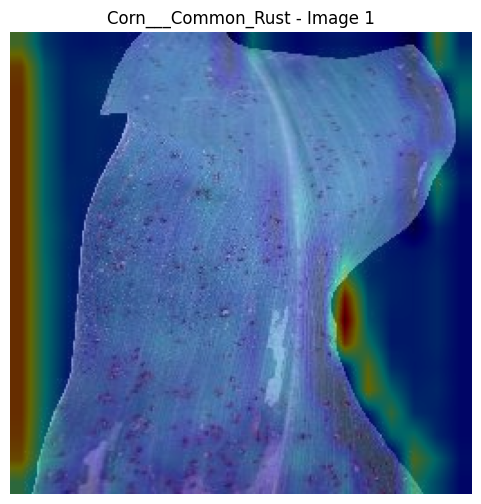

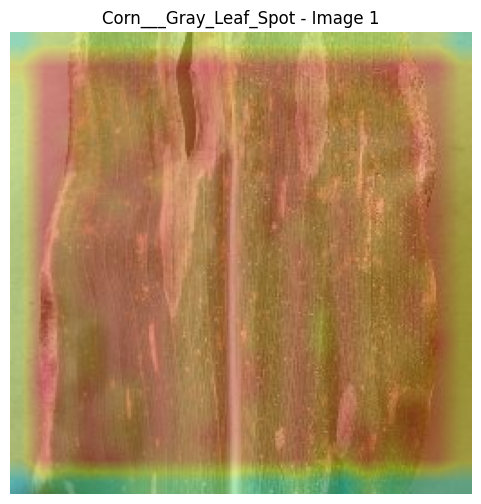

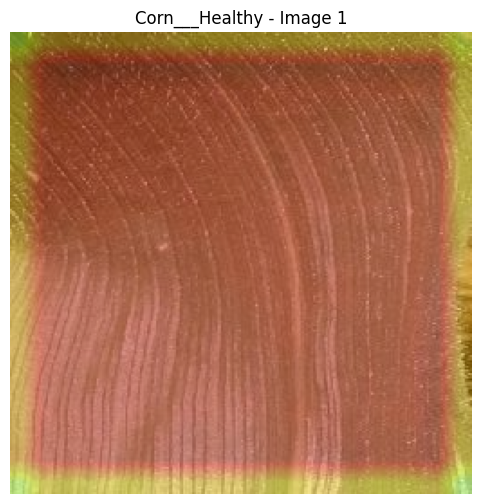

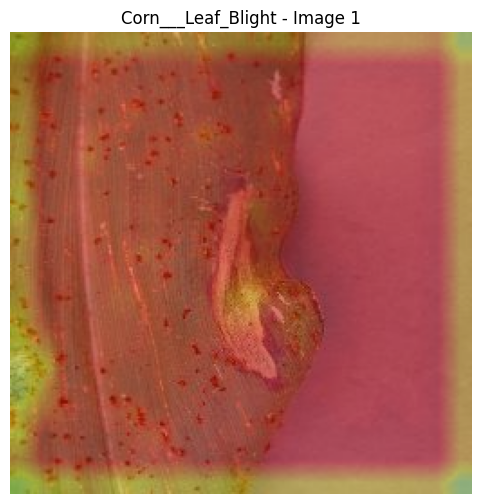

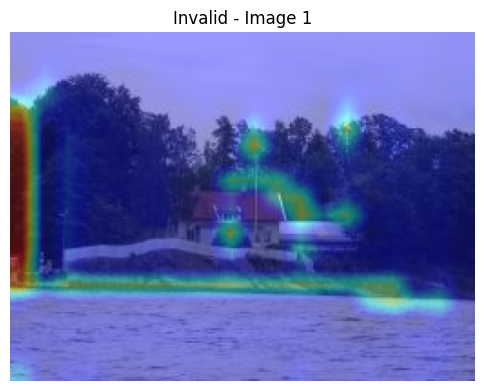

...

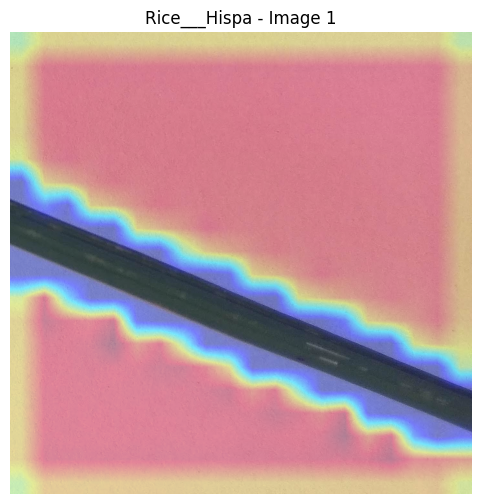

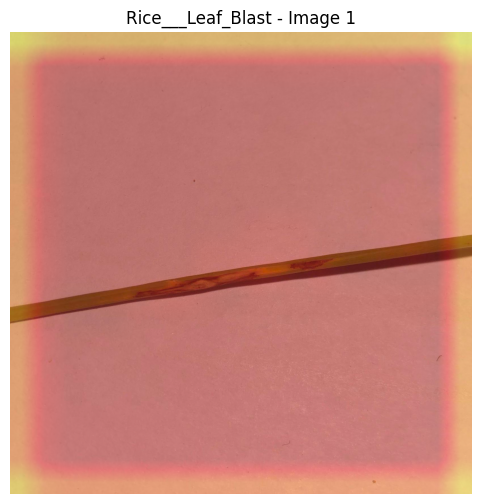

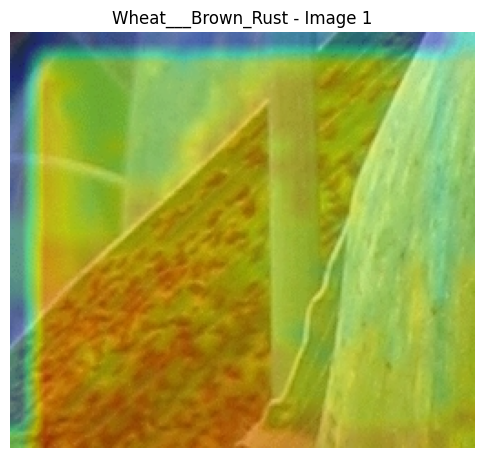

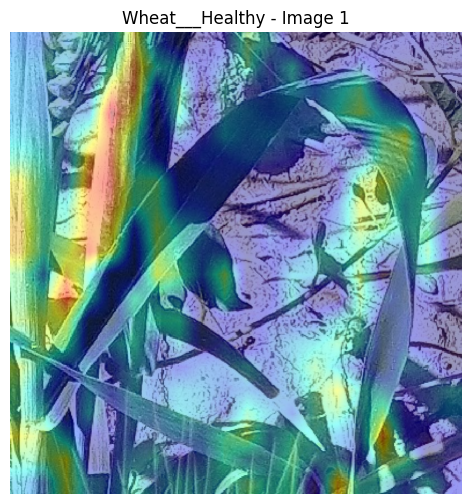

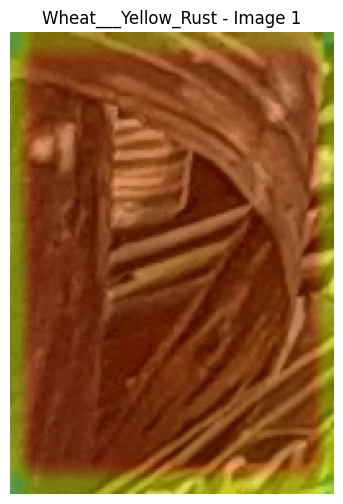

In [13]:
'''


FOR DENSE BLOCK STREAM GRADCAM IN THE BANGLADESHI CROPS DATASET


'''
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import os

# --------- CONFIGURE THIS ---------
last_conv_layer_name = "concatenate_13"  # Last conv layer of your model
dataset_root = "/kaggle/input/bangladeshi-crops-disease-dataset/CropDisease/Crop___DIsease"
target_size = (160, 160)  # Change to your model's input size
images_per_class = 1 # Number of images per class to visualize
# -----------------------------------

# Load class names
classes = sorted(os.listdir(dataset_root))

# Function to generate Grad-CAM heatmap
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_outputs), axis=-1)
    heatmap = np.maximum(heatmap, 0) / (tf.reduce_max(heatmap) + tf.keras.backend.epsilon())
    return heatmap.numpy()

# Iterate over each class
for class_name in classes:
    class_dir = os.path.join(dataset_root, class_name)
    if not os.path.isdir(class_dir):
        continue

    image_files = os.listdir(class_dir)[:images_per_class]

    for idx, img_file in enumerate(image_files):
        img_path = os.path.join(class_dir, img_file)

        # Load image
        img = tf.keras.preprocessing.image.load_img(img_path)
        original_img_size = img.size

        img_resized = tf.keras.preprocessing.image.img_to_array(img.resize(target_size))
        img_array = tf.cast(np.expand_dims(img_resized, axis=0) / 255.0, tf.float32)

        # Generate heatmap
        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name=last_conv_layer_name)

        # Resize heatmap to original image size
        heatmap_resized = tf.image.resize(heatmap[..., tf.newaxis], (original_img_size[1], original_img_size[0]))
        heatmap_resized = tf.squeeze(heatmap_resized).numpy()

        heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_resized), cv2.COLORMAP_JET)

        # Superimpose heatmap on original image
        superimposed_img = cv2.addWeighted(
            cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR),
            0.6, heatmap_colored, 0.4, 0
        )

        # Display result
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(f"{class_name} - Image {idx+1}")
        plt.show()


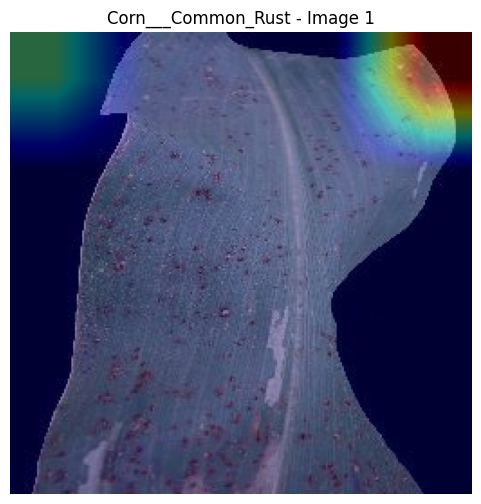

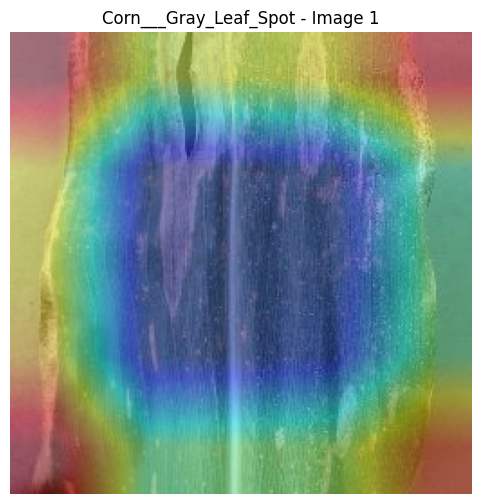

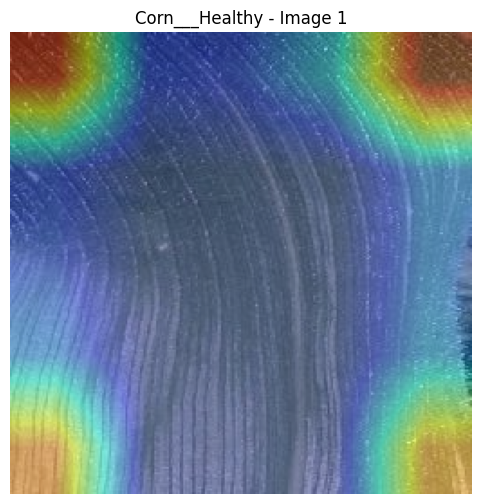

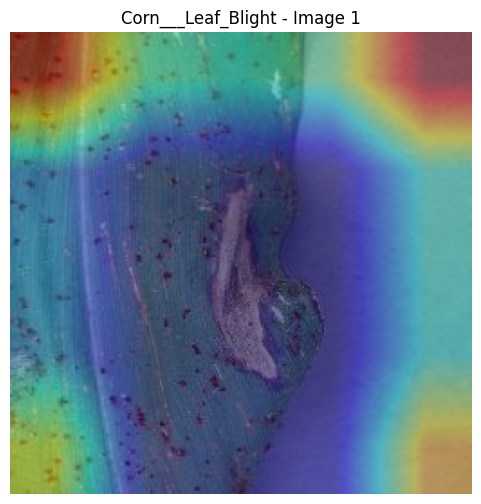

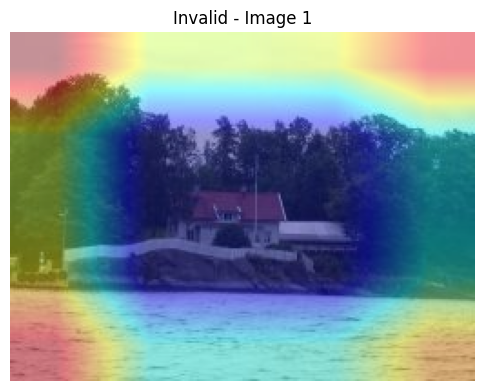

...

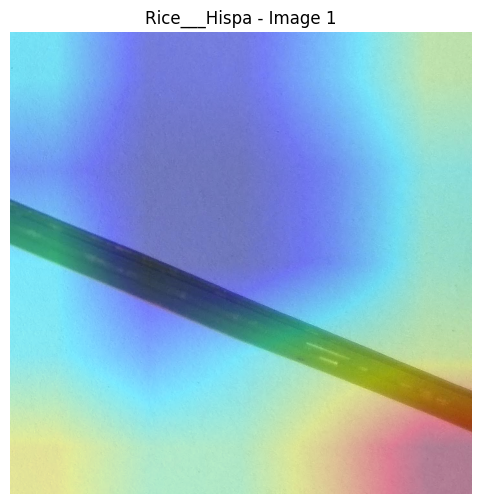

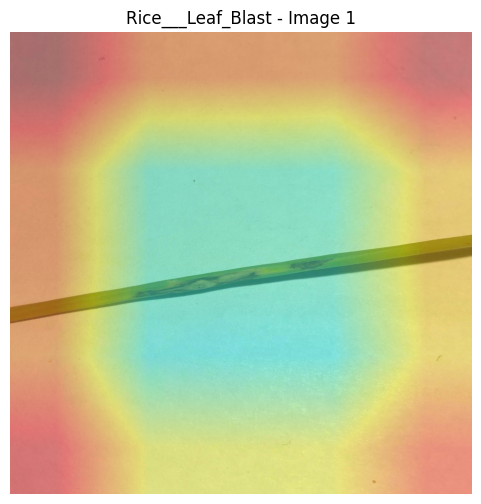

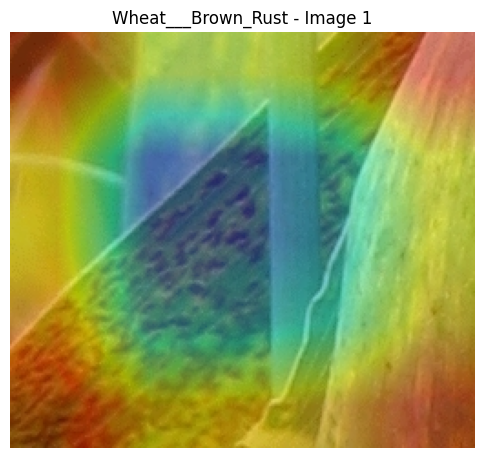

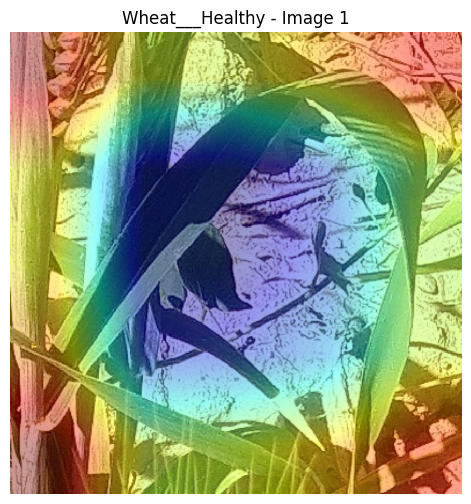

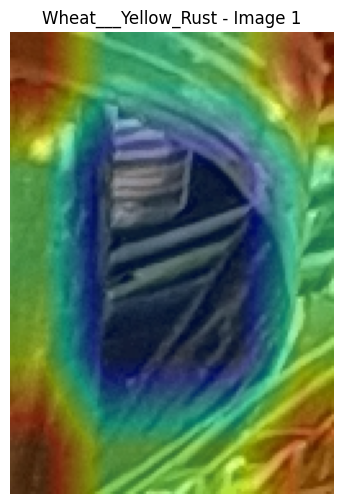

In [14]:
'''


FOR RESIDUAL BLOCK STREAM GRADCAM IN THE BANGLADESHI CROPS DATASET


'''
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import os

# --------- CONFIGURE THIS ---------
last_conv_layer_name = "add_2"  # Last conv layer of your model
dataset_root = "/kaggle/input/bangladeshi-crops-disease-dataset/CropDisease/Crop___DIsease"
target_size = (160, 160)  # Change to your model's input size
images_per_class = 1 # Number of images per class to visualize
# -----------------------------------

# Load class names
classes = sorted(os.listdir(dataset_root))

# Function to generate Grad-CAM heatmap
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_outputs), axis=-1)
    heatmap = np.maximum(heatmap, 0) / (tf.reduce_max(heatmap) + tf.keras.backend.epsilon())
    return heatmap.numpy()

# Iterate over each class
for class_name in classes:
    class_dir = os.path.join(dataset_root, class_name)
    if not os.path.isdir(class_dir):
        continue

    image_files = os.listdir(class_dir)[:images_per_class]

    for idx, img_file in enumerate(image_files):
        img_path = os.path.join(class_dir, img_file)

        # Load image
        img = tf.keras.preprocessing.image.load_img(img_path)
        original_img_size = img.size

        img_resized = tf.keras.preprocessing.image.img_to_array(img.resize(target_size))
        img_array = tf.cast(np.expand_dims(img_resized, axis=0) / 255.0, tf.float32)

        # Generate heatmap
        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name=last_conv_layer_name)

        # Resize heatmap to original image size
        heatmap_resized = tf.image.resize(heatmap[..., tf.newaxis], (original_img_size[1], original_img_size[0]))
        heatmap_resized = tf.squeeze(heatmap_resized).numpy()

        heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_resized), cv2.COLORMAP_JET)

        # Superimpose heatmap on original image
        superimposed_img = cv2.addWeighted(
            cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR),
            0.6, heatmap_colored, 0.4, 0
        )

        # Display result
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(f"{class_name} - Image {idx+1}")
        plt.show()


In [15]:
model=model_plant_village

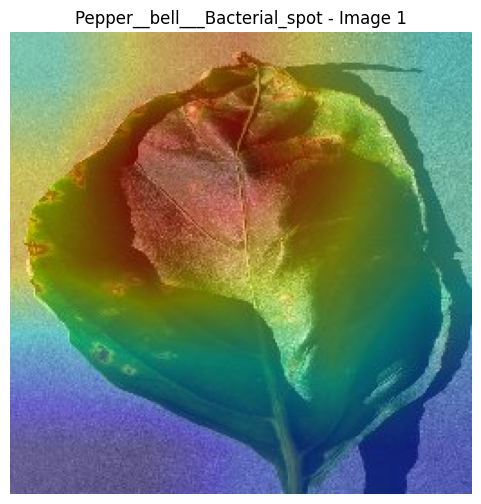

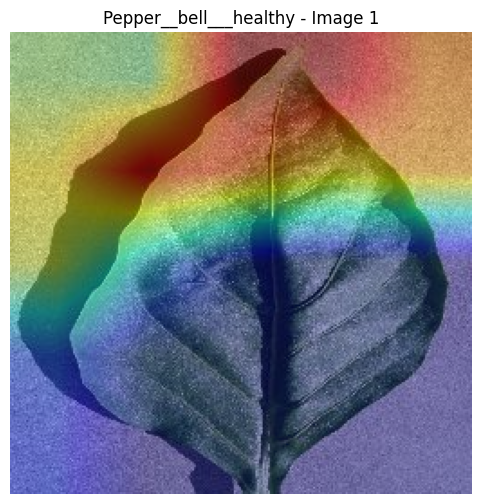

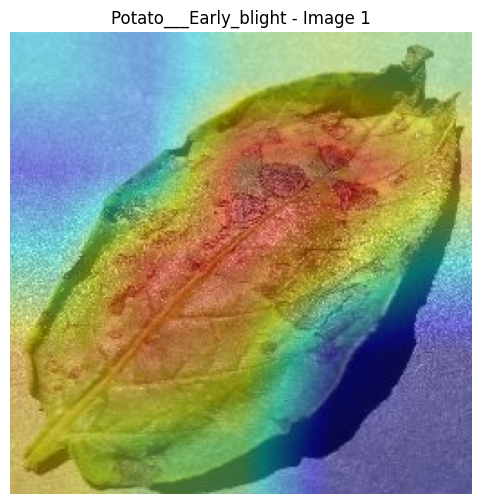

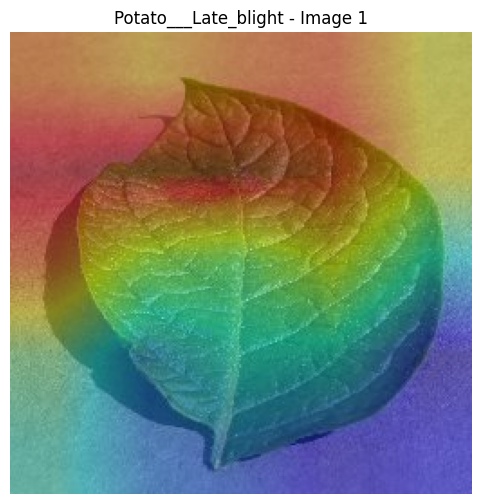

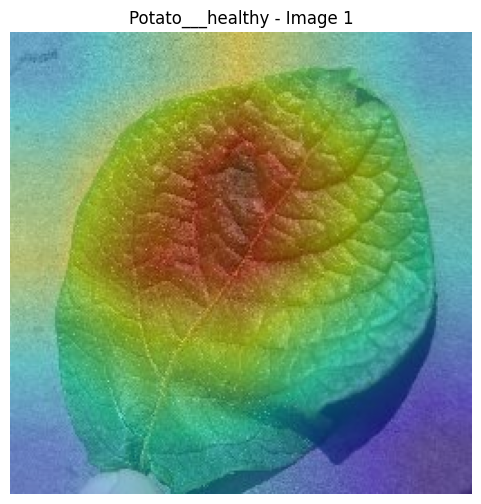

...

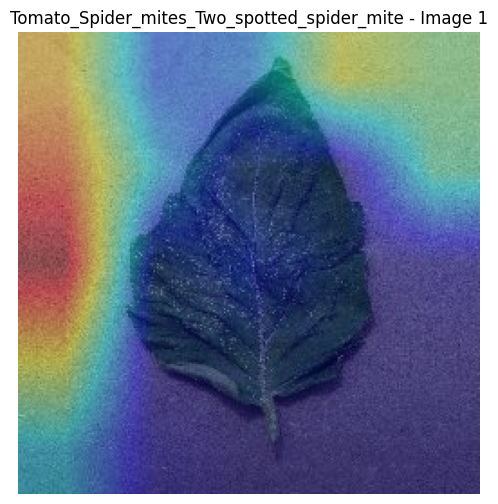

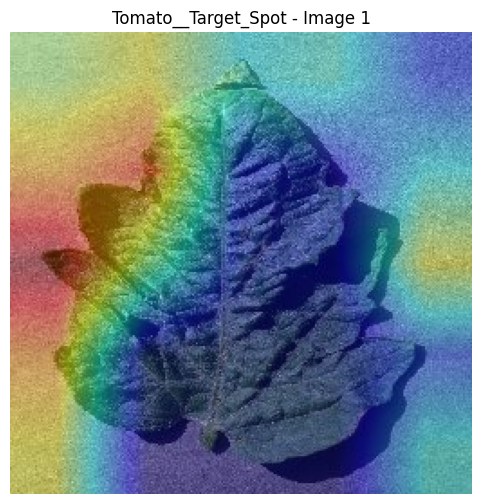

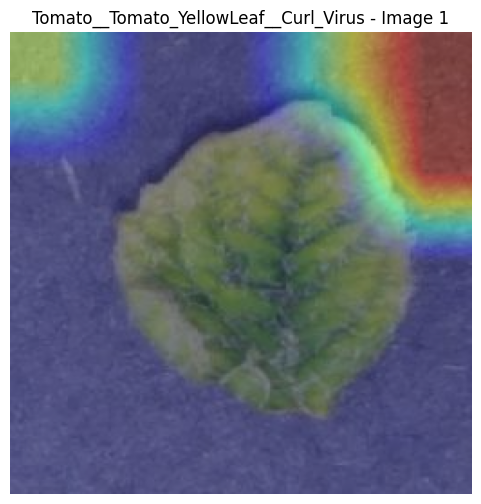

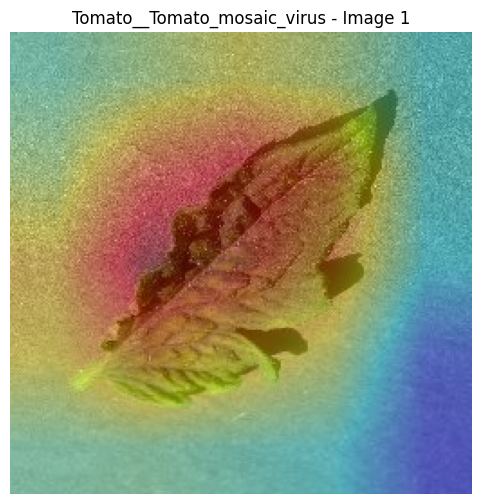

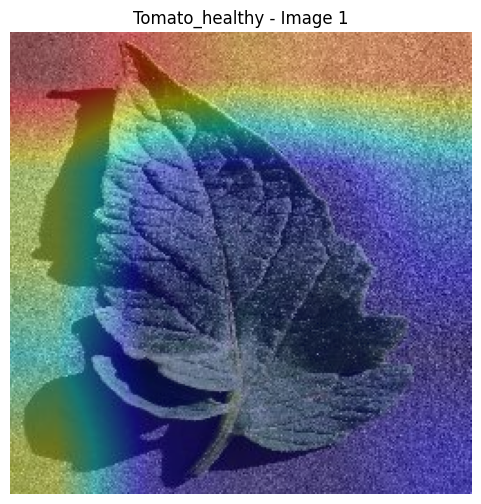

In [16]:
'''


FOR RESIDUAL BLOCK STREAM GRADCAM IN THE PLANT VILLAGRE CROPS DATASET


'''
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import os

# --------- CONFIGURE THIS ---------
last_conv_layer_name = "add_2"  # Last conv layer of your model
dataset_root = "/kaggle/input/plantdisease/PlantVillage"
target_size = (160, 160)  # Change to your model's input size
images_per_class = 1 # Number of images per class to visualize
# -----------------------------------

# Load class names
classes = sorted(os.listdir(dataset_root))

# Function to generate Grad-CAM heatmap
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_outputs), axis=-1)
    heatmap = np.maximum(heatmap, 0) / (tf.reduce_max(heatmap) + tf.keras.backend.epsilon())
    return heatmap.numpy()

# Iterate over each class
for class_name in classes:
    class_dir = os.path.join(dataset_root, class_name)
    if not os.path.isdir(class_dir):
        continue

    image_files = os.listdir(class_dir)[:images_per_class]

    for idx, img_file in enumerate(image_files):
        img_path = os.path.join(class_dir, img_file)

        # Load image
        img = tf.keras.preprocessing.image.load_img(img_path)
        original_img_size = img.size

        img_resized = tf.keras.preprocessing.image.img_to_array(img.resize(target_size))
        img_array = tf.cast(np.expand_dims(img_resized, axis=0) / 255.0, tf.float32)

        # Generate heatmap
        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name=last_conv_layer_name)

        # Resize heatmap to original image size
        heatmap_resized = tf.image.resize(heatmap[..., tf.newaxis], (original_img_size[1], original_img_size[0]))
        heatmap_resized = tf.squeeze(heatmap_resized).numpy()

        heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_resized), cv2.COLORMAP_JET)

        # Superimpose heatmap on original image
        superimposed_img = cv2.addWeighted(
            cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR),
            0.6, heatmap_colored, 0.4, 0
        )

        # Display result
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(f"{class_name} - Image {idx+1}")
        plt.show()


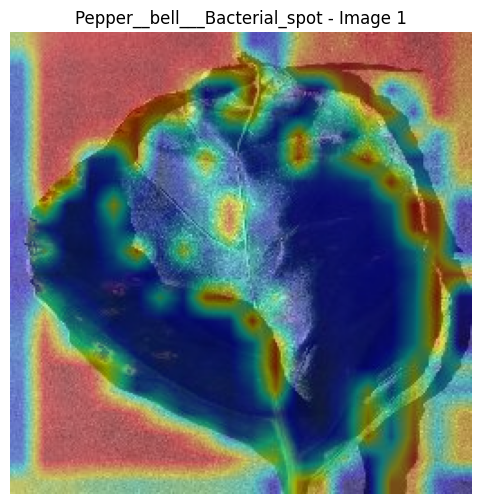

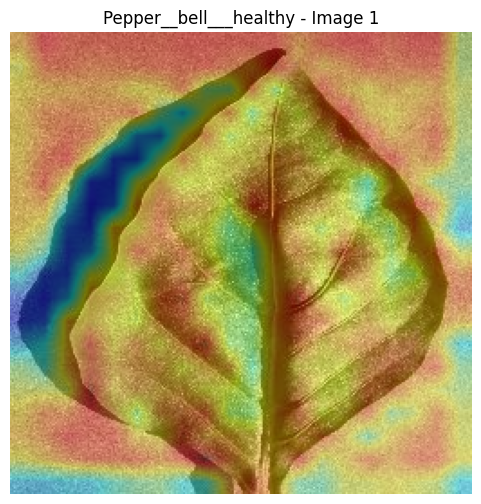

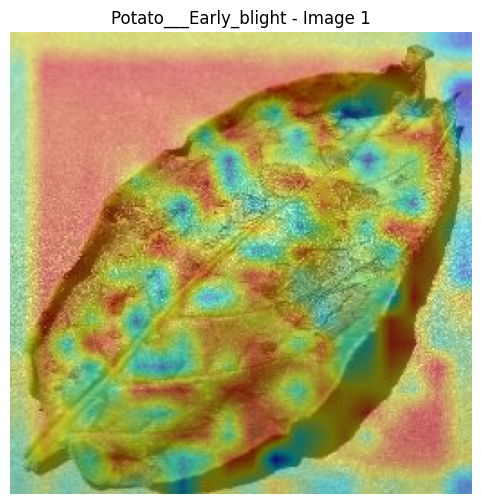

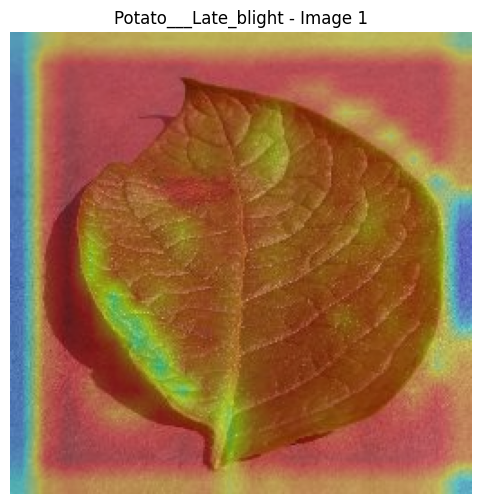

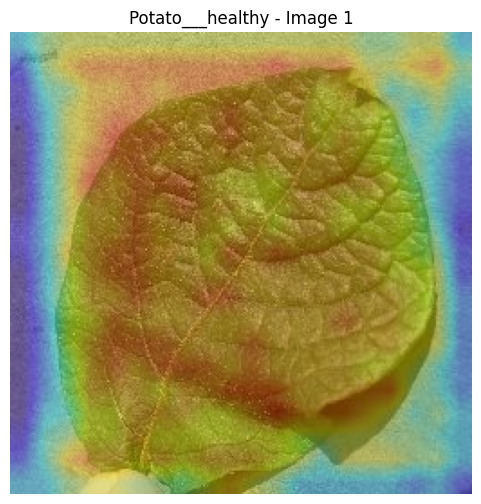

...

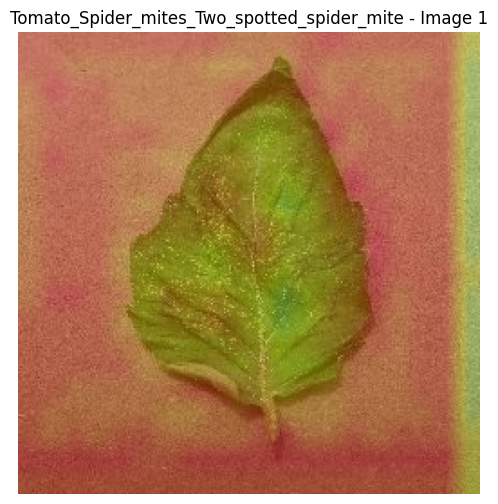

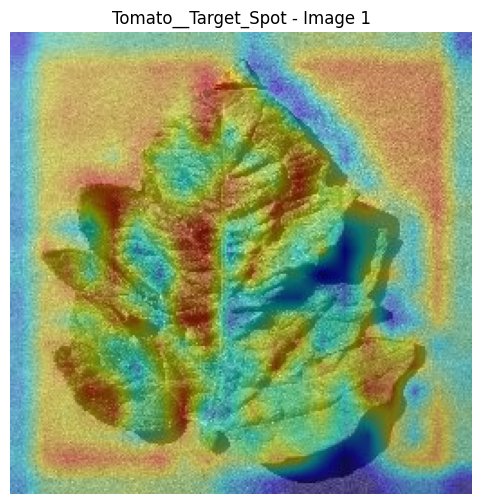

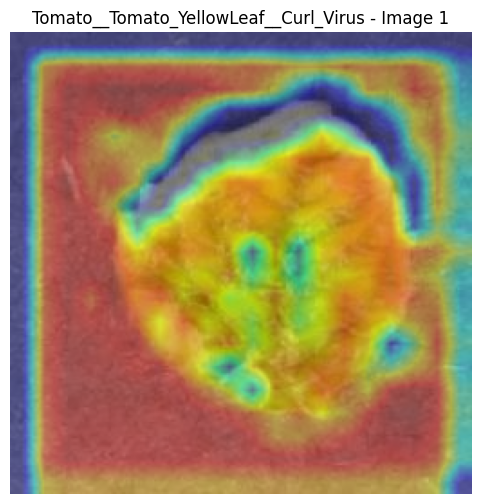

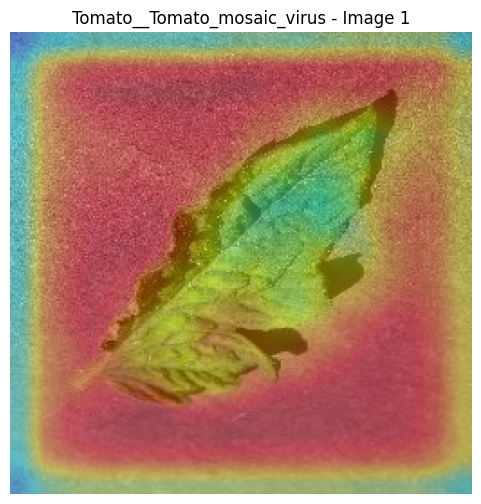

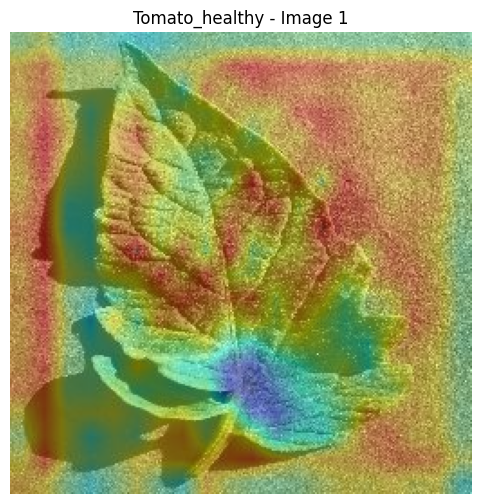

In [17]:
'''


FOR DENSE BLOCK STREAM GRADCAM IN THE PLANT VILLAGRE CROPS DATASET


'''
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import os

# --------- CONFIGURE THIS ---------
last_conv_layer_name = "concatenate_13"  # Last conv layer of your model
dataset_root = "/kaggle/input/plantdisease/PlantVillage"
target_size = (160, 160)  # Change to your model's input size
images_per_class = 1  # Number of images per class to visualize
# -----------------------------------

# Load class names
classes = sorted(os.listdir(dataset_root))

# Function to generate Grad-CAM heatmap
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_outputs), axis=-1)
    heatmap = np.maximum(heatmap, 0) / (tf.reduce_max(heatmap) + tf.keras.backend.epsilon())
    return heatmap.numpy()

# Iterate over each class
for class_name in classes:
    class_dir = os.path.join(dataset_root, class_name)
    if not os.path.isdir(class_dir):
        continue

    image_files = os.listdir(class_dir)[:images_per_class]

    for idx, img_file in enumerate(image_files):
        img_path = os.path.join(class_dir, img_file)

        # Load image
        img = tf.keras.preprocessing.image.load_img(img_path)
        original_img_size = img.size

        img_resized = tf.keras.preprocessing.image.img_to_array(img.resize(target_size))
        img_array = tf.cast(np.expand_dims(img_resized, axis=0) / 255.0, tf.float32)

        # Generate heatmap
        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name=last_conv_layer_name)

        # Resize heatmap to original image size
        heatmap_resized = tf.image.resize(heatmap[..., tf.newaxis], (original_img_size[1], original_img_size[0]))
        heatmap_resized = tf.squeeze(heatmap_resized).numpy()

        heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_resized), cv2.COLORMAP_JET)

        # Superimpose heatmap on original image
        superimposed_img = cv2.addWeighted(
            cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR),
            0.6, heatmap_colored, 0.4, 0
        )

        # Display result
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(f"{class_name} - Image {idx+1}")
        plt.show()
